In [1]:
import numpy as np
import pandas as pd
import os

In [ ]:
!pip install sng4onnx onnx_graphsurgeon onnx2tf onnxslim  onnxruntime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.9/152.9 kB 14.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.3/390.3 kB 37.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached pybind11-3.0.1-py3-none-any.whl.metadata (10.0 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.9/57.9 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 469.2/469.2 kB 40.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 167.3/167.3 kB 18.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 94.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.1/18.1 MB 93.2 MB/s eta 0:00:00
Using cached pybind11-3.0.1-py3-none-any.whl (293 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 7.3 MB/s eta 0:00:00
  Created wheel for tflite_support: filename=tflite_support-0.1.0a1-cp312-cp312-linux_x86_64.whl size=6042508 sha256=8d2d30

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import patches
import seaborn as sns
import os
import random
import re
import shutil
sns.set_style('darkgrid')
sns.set_palette('pastel')

import warnings
warnings.filterwarnings('ignore')

In [4]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("akhatova/pcb-defects")

print("Path to dataset files:", path)

Using Colab cache for faster access to the 'pcb-defects' dataset.
Path to dataset files: /kaggle/input/pcb-defects


In [6]:
input_dir= '/kaggle/input/pcb-defects/PCB_DATASET'
os.listdir(input_dir)

['rotate.py', 'PCB_USED', 'Annotations', 'images', 'rotation']

In [7]:
template_dir=os.path.join(input_dir,'PCB_USED')
template_dir

'/kaggle/input/pcb-defects/PCB_DATASET/PCB_USED'

In [8]:
#Creating function to visualize images:
def visualize_img(dir_name,nos_):
    k=1
    plt.figure(figsize=(8,(nos_//2)*6))
    for filename in os.listdir(dir_name)[0:nos_]:
        if filename.lower().endswith(('.jpg','.jpeg','.png')):
            ax=plt.subplot((nos_//2)+1,2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()

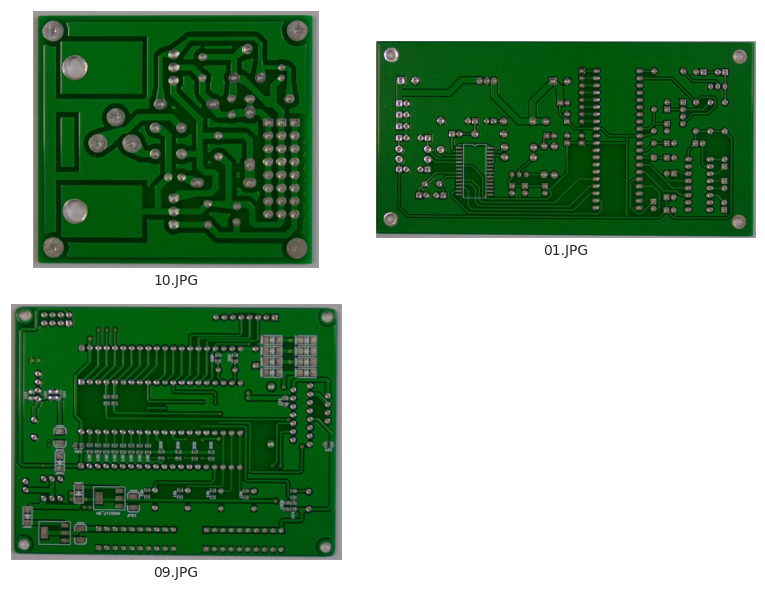

No of template images:10


In [9]:
visualize_img(template_dir,nos_=3)

print(f'No of template images:{len(os.listdir(template_dir))}')

In [10]:
#Defining the image directory
img_dir=os.path.join(input_dir,'images')

#Listing the types of defects
os.listdir(img_dir)
types_defect=os.listdir(os.path.join(input_dir,'images'))
types_defect

['Mouse_bite',
 'Spur',
 'Open_circuit',
 'Short',
 'Missing_hole',
 'Spurious_copper']

In [11]:
#Creating an image path list for ready refernce
img_path_list=[]
#Creating img_path list
for sub_cat in types_defect:
    for file in os.listdir(os.path.join(img_dir,sub_cat)):

        img_path_list.append(os.path.join(img_dir,sub_cat,file))


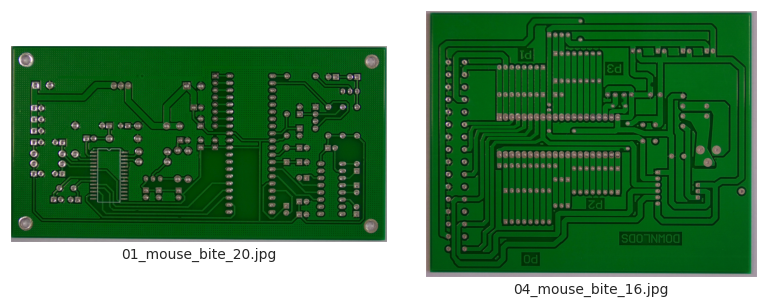

No of Mouse_bite images:115


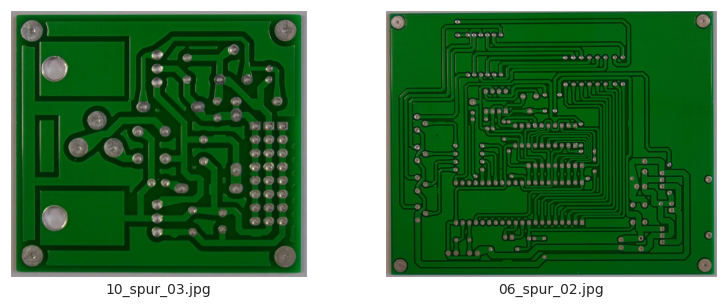

No of Spur images:115


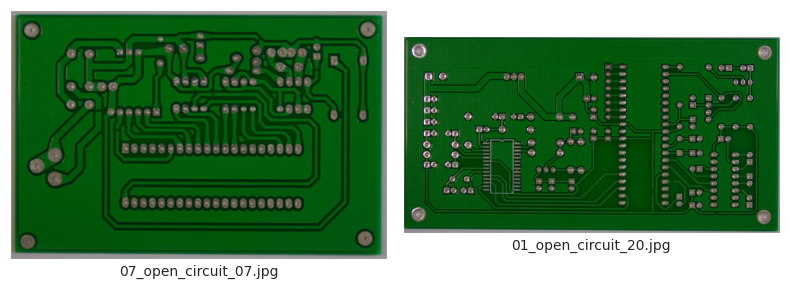

No of Open_circuit images:116


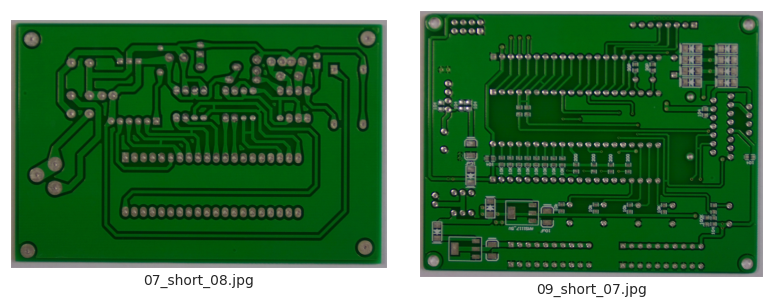

No of Short images:116


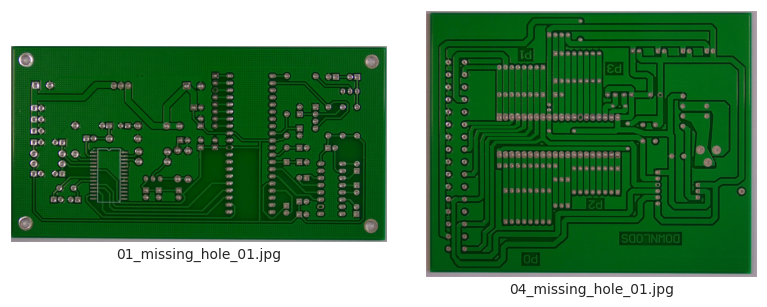

No of Missing_hole images:115


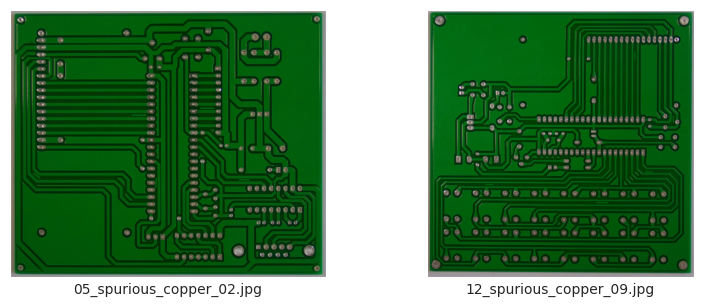

No of Spurious_copper images:116


In [12]:
#Vizualizing defect images for each type
df_defect=pd.DataFrame(columns=['No of defect']) #dataframe for counting no of defects
for sub_cat in types_defect:
    visualize_img(os.path.join(img_dir,sub_cat),nos_=2)  #Visualizing 2 types of defect for each type

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(img_dir,sub_cat)))}')

    df_defect.loc[sub_cat]=len(os.listdir(os.path.join(img_dir,sub_cat)))

In [13]:
#No. of defects by type
df_defect

,No of defect
Mouse_bite,115
Spur,115
Open_circuit,116
Short,116
Missing_hole,115
Spurious_copper,116


In [14]:
rotated_dir=os.path.join(input_dir,'rotation')
os.listdir(rotated_dir)

['Missing_hole_rotation',
 'Spur_rotation',
 'Mouse_bite_angles.txt',
 'Missing_hole_angles.txt',
 'Open_circuit_rotation',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Short_angles.txt',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Open_circuit_angles.txt',
 'Mouse_bite_rotation']

In [15]:
rotated_angle_list=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')]
rotated_angle_list

['Mouse_bite_angles.txt',
 'Missing_hole_angles.txt',
 'Spurious_copper_angles.txt',
 'Spur_angles.txt',
 'Short_angles.txt',
 'Open_circuit_angles.txt']

In [16]:
types_defect_rotated=[j for j in os.listdir(rotated_dir) if j.endswith('.txt')==False]
types_defect_rotated

['Missing_hole_rotation',
 'Spur_rotation',
 'Open_circuit_rotation',
 'Short_rotation',
 'Spurious_copper_rotation',
 'Mouse_bite_rotation']

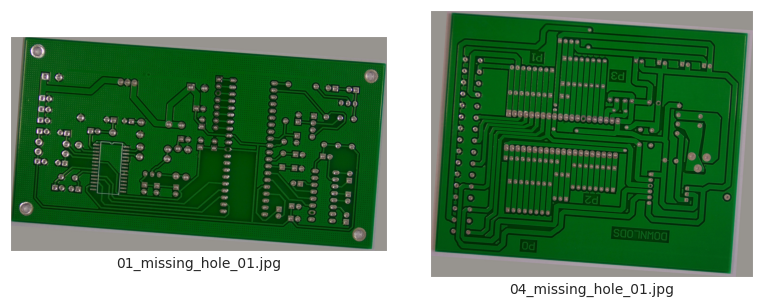

No of Missing_hole_rotation images:115


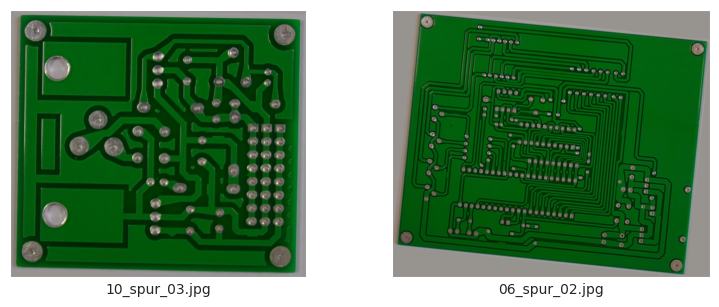

No of Spur_rotation images:115


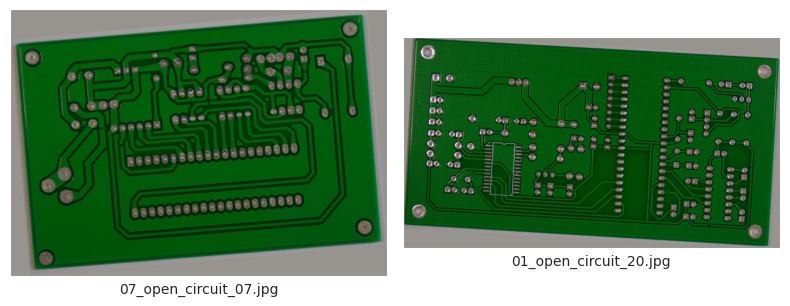

No of Open_circuit_rotation images:116


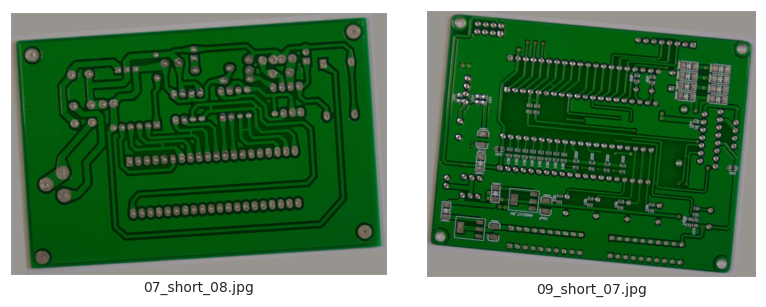

No of Short_rotation images:116


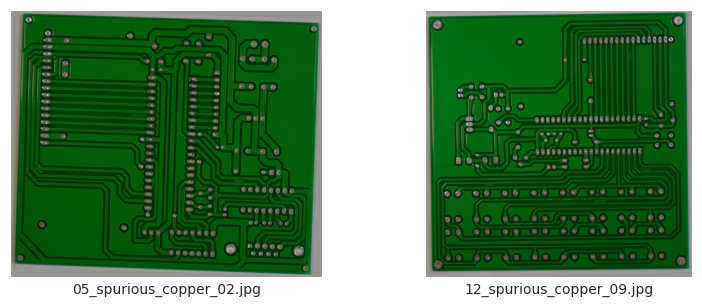

No of Spurious_copper_rotation images:116


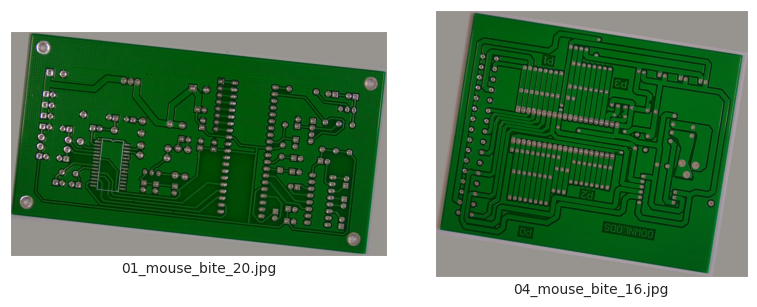

No of Mouse_bite_rotation images:115


In [17]:
#Vizualizing rotated defects
df_defect_rotated=pd.DataFrame(columns=['No of defect'])
for sub_cat in types_defect_rotated:
    visualize_img(os.path.join(rotated_dir,sub_cat),nos_=2)

    print(f'No of {sub_cat} images:{len(os.listdir(os.path.join(rotated_dir,sub_cat)))}')

    df_defect_rotated.loc[sub_cat]=len(os.listdir(os.path.join(rotated_dir,sub_cat)))

In [18]:
#No. of defects by type  rotated
df_defect_rotated

,No of defect
Missing_hole_rotation,115
Spur_rotation,115
Open_circuit_rotation,116
Short_rotation,116
Spurious_copper_rotation,116
Mouse_bite_rotation,115


In [19]:
#Reading the rotation text files

df_rotation_angle=pd.DataFrame(columns=['Line','Angle'])
for filename in rotated_angle_list:
    with open(os.path.join(rotated_dir,filename),'r') as f:
        lines=f.readlines()
        for line in lines:
            text,angle=line.split()
            df_rotation_angle=pd.concat([df_rotation_angle,pd.DataFrame({'Line':[text],'Angle':[angle]})],axis=0)

In [20]:
df_rotation_angle

,Line,Angle
0,04_mouse_bite_06,-4
0,12_mouse_bite_04,10
0,01_mouse_bite_17,10
0,04_mouse_bite_08,7
0,01_mouse_bite_01,-6
...,...,...
0,04_open_circuit_20,-5
0,09_open_circuit_07,-3
0,04_open_circuit_08,-2
0,10_open_circuit_04,7


In [21]:
annote_dir=os.path.join(input_dir,'Annotations')
annote_dir

'/kaggle/input/pcb-defects/PCB_DATASET/Annotations'

In [22]:
type_annot=os.listdir(annote_dir)
type_annot

['Mouse_bite',
 'Spur',
 'Open_circuit',
 'Short',
 'Missing_hole',
 'Spurious_copper']

In [23]:
df_annot_nos=pd.DataFrame(columns=['No of annotations'])
#Checking the length of annotation itms
for i in type_annot:
    df_annot_nos.loc[i]=len(os.listdir(os.path.join(annote_dir,i)))
df_annot_nos

,No of annotations
Mouse_bite,115
Spur,115
Open_circuit,116
Short,116
Missing_hole,115
Spurious_copper,116


In [24]:
#Checking the type of files
file_list=os.listdir(os.path.join(annote_dir,'Mouse_bite'))
file_list[0:5]

['01_mouse_bite_11.xml',
 '01_mouse_bite_17.xml',
 '08_mouse_bite_08.xml',
 '08_mouse_bite_02.xml',
 '07_mouse_bite_03.xml']

In [25]:
#importing xml ET to parse xml file
import xml.etree.ElementTree as ET

In [26]:
tree = ET.parse(os.path.join(os.path.join(annote_dir,'Mouse_bite'),'01_mouse_bite_11.xml'))
root = tree.getroot()

In [27]:
#getting the structure of XML file
print(ET.tostring(root, encoding='utf8').decode('utf8'))

<?xml version='1.0' encoding='utf8'?>
<annotation>
	<folder>Mouse_bite</folder>
	<filename>01_mouse_bite_11.jpg</filename>
	<path>/home/weapon/Desktop/PCB_DATASET/Mouse_bite/01_mouse_bite_11.jpg</path>
	<source>
		<database>Unknown</database>
	</source>
	<size>
		<width>3034</width>
		<height>1586</height>
		<depth>3</depth>
	</size>
	<segmented>0</segmented>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1199</xmin>
			<ymin>966</ymin>
			<xmax>1234</xmax>
			<ymax>1004</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>2042</xmin>
			<ymin>755</ymin>
			<xmax>2073</xmax>
			<ymax>786</ymax>
		</bndbox>
	</object>
	<object>
		<name>mouse_bite</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>1472</xmin>
			<ymin>607</ymin>
		

In [28]:
#Parsing XML to return Bounding box dimensions
def parse_xml(xml_file):

    data=[]

    tree = ET.parse(xml_file)
    root = tree.getroot()

    filename = root.find('filename').text
    width = int(root.find('size/width').text)
    height = int(root.find('size/height').text)
    for obj in root.findall('object'):
        name = obj.find('name').text
        xmin = int(obj.find('bndbox/xmin').text)
        ymin = int(obj.find('bndbox/ymin').text)
        xmax = int(obj.find('bndbox/xmax').text)
        ymax = int(obj.find('bndbox/ymax').text)

        data.append({
            'filename': filename,
            'width': width,
            'height': height,
            'class': name,
            'xmin': xmin,
            'ymin': ymin,
            'xmax': xmax,
            'ymax': ymax
        })

    return data

In [29]:
#Retrieving data for all files
data=[]
all_data=[]

for x in type_annot:
    for file in os.listdir(os.path.join(annote_dir,x)):
        xml_file_path=os.path.join(os.path.join(annote_dir,x),file)
        data=parse_xml(xml_file_path)
        all_data.extend(data)

In [30]:
#Creating a dataframe to store the annotations
df_annot=pd.DataFrame(all_data)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1199,966,1234,1004
1,01_mouse_bite_11.jpg,3034,1586,mouse_bite,2042,755,2073,786
2,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1472,607,1507,639
3,01_mouse_bite_17.jpg,3034,1586,mouse_bite,2168,854,2200,887
4,01_mouse_bite_17.jpg,3034,1586,mouse_bite,1513,919,1545,957
...,...,...,...,...,...,...,...,...
2948,06_spurious_copper_09.jpg,2868,2316,spurious_copper,706,892,741,991
2949,06_spurious_copper_09.jpg,2868,2316,spurious_copper,1055,1136,1114,1171
2950,04_spurious_copper_04.jpg,3056,2464,spurious_copper,1796,1019,1839,1089
2951,04_spurious_copper_04.jpg,3056,2464,spurious_copper,474,1236,527,1382


Text(0.5, 0, 'No of defects in one PCB')

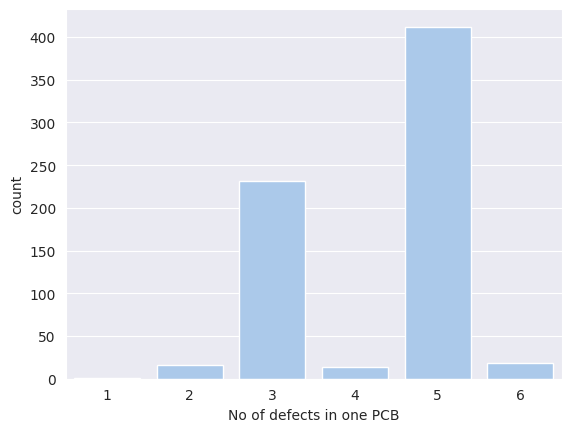

In [31]:
#Visualizing the no of defects in each pcb
df_multiple_defects=pd.DataFrame(df_annot['filename'].value_counts())
sns.countplot(df_multiple_defects,x='count')
plt.xlabel('No of defects in one PCB')

In [32]:
#Defin|g a function to view image along with bounding box

def draw_bounding_boxes(image_path, bounding_boxes,annotation):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(15,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box
    for bbox in bounding_boxes:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])



    # Show the plot
    plt.show()

In [33]:
#Getting filename from filepath
filepath=img_path_list[0]
filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
filename

'01_mouse_bite_20.jpg'

In [34]:
#Defining function to select the a file and return image along with bounding box
def visualize_annotations(list_image_path,df):
    for i in list_image_path:
        filepath=i
        filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
        df_selected=df[df['filename']==filename]
        width=df_selected['width'].values
        height=df_selected['height'].values
        class_name=df_selected['class'].values
        xmin=df_selected['xmin'].values
        ymin=df_selected['ymin'].values
        xmax=df_selected['xmax'].values
        ymax=df_selected['ymax'].values

        bbox=zip(xmin,ymin,xmax,ymax)
        draw_bounding_boxes(filepath, bbox,class_name[0])

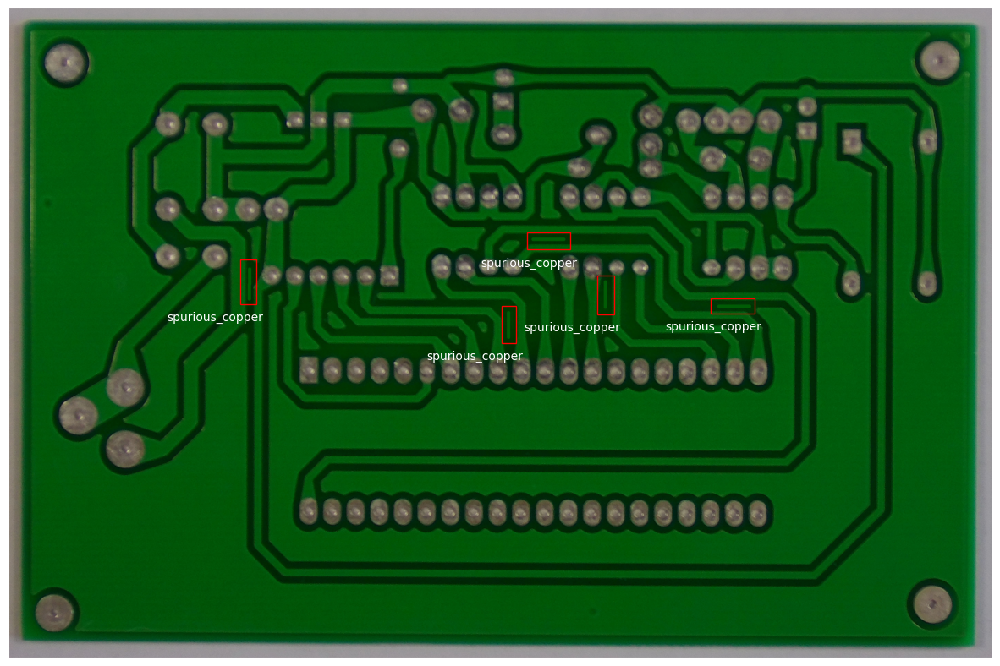

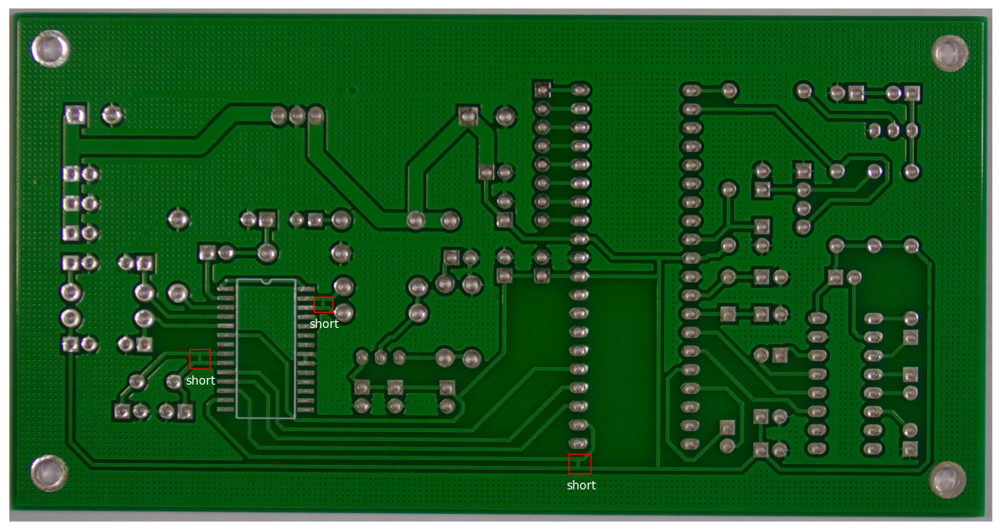

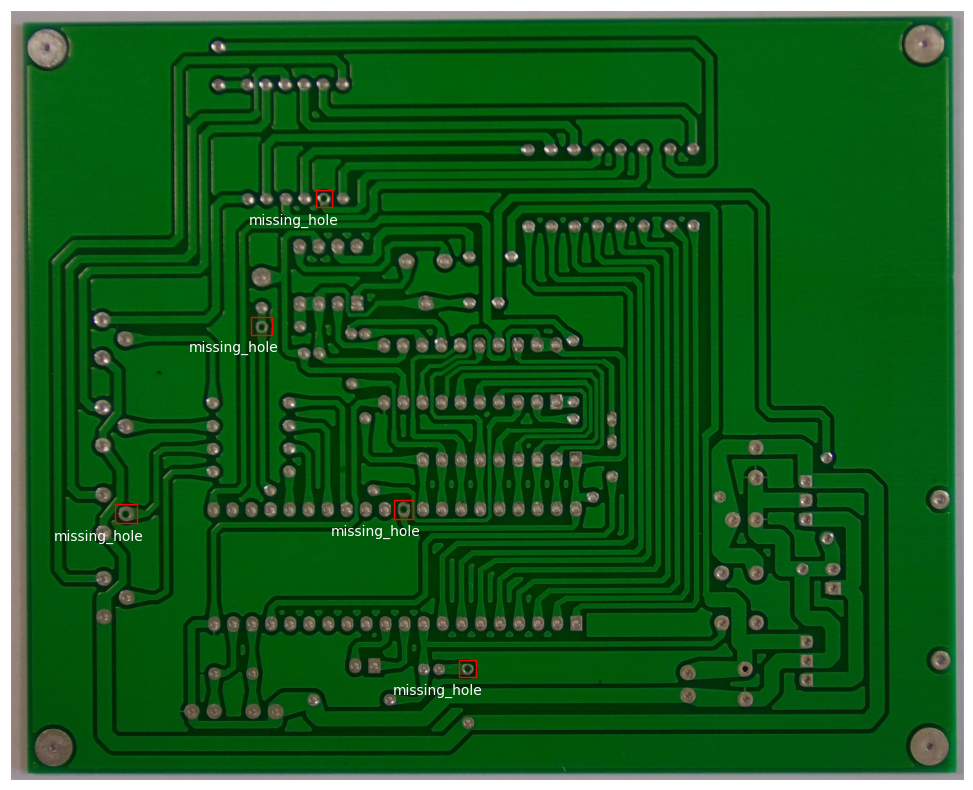

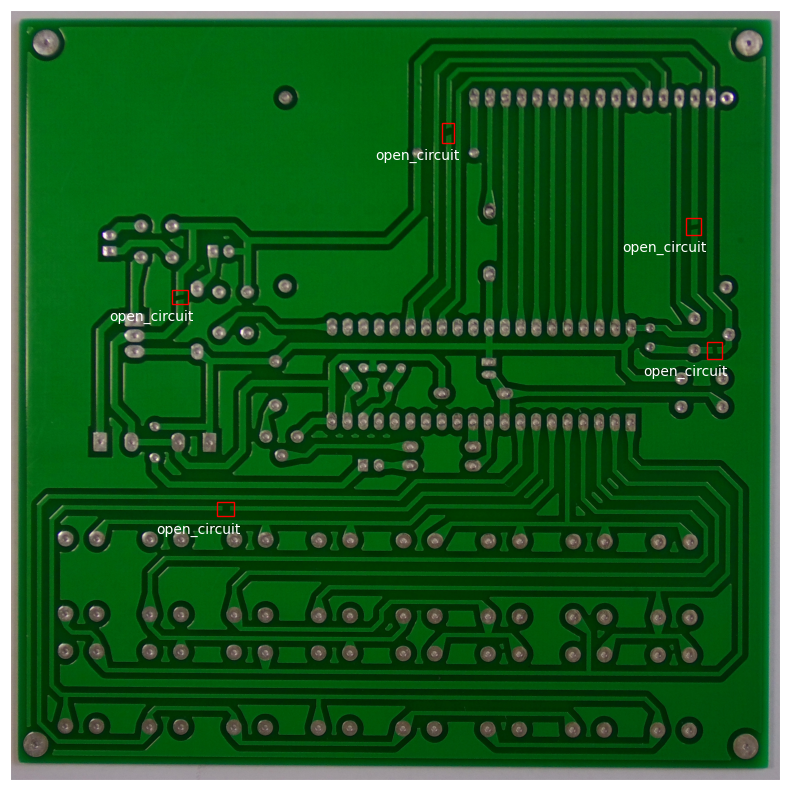

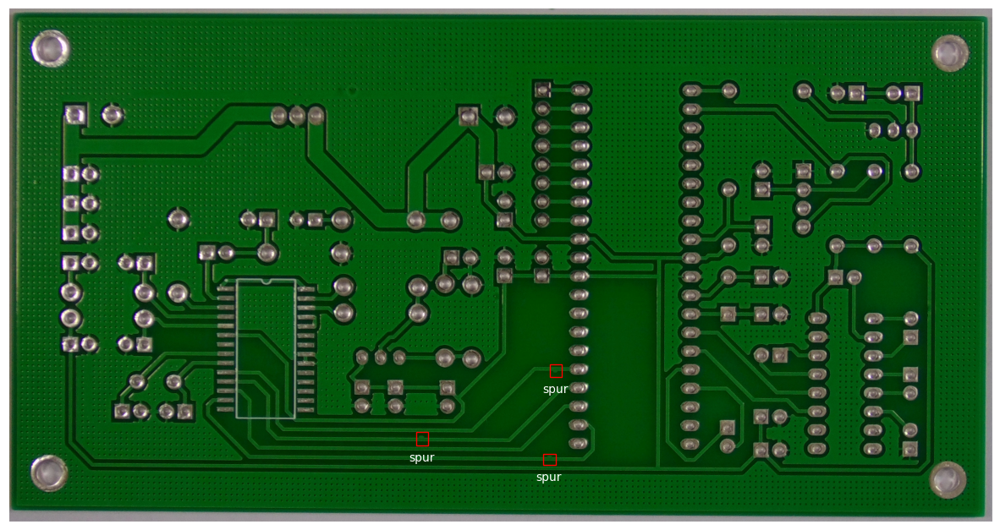

In [35]:
image_path_shuffle=img_path_list
random.shuffle(image_path_shuffle)

visualize_annotations(image_path_shuffle[0:5],df_annot)

In [36]:
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax
0,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1199,966,1234,1004
1,01_mouse_bite_11.jpg,3034,1586,mouse_bite,2042,755,2073,786
2,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1472,607,1507,639
3,01_mouse_bite_17.jpg,3034,1586,mouse_bite,2168,854,2200,887
4,01_mouse_bite_17.jpg,3034,1586,mouse_bite,1513,919,1545,957
...,...,...,...,...,...,...,...,...
2948,06_spurious_copper_09.jpg,2868,2316,spurious_copper,706,892,741,991
2949,06_spurious_copper_09.jpg,2868,2316,spurious_copper,1055,1136,1114,1171
2950,04_spurious_copper_04.jpg,3056,2464,spurious_copper,1796,1019,1839,1089
2951,04_spurious_copper_04.jpg,3056,2464,spurious_copper,474,1236,527,1382


In [37]:
root_dir=os.getcwd()

In [38]:
#Creating the dataset directory along with images and labels sub-directory
os.makedirs(os.path.join(root_dir,'dataset'),exist_ok=True)
dataset_dir=os.path.join(root_dir,'dataset')

images_dir = os.path.join(dataset_dir, 'images')  #images directory
labels_dir = os.path.join(dataset_dir, 'labels')  #annotations directory
os.makedirs(images_dir,exist_ok=True)
os.makedirs(labels_dir,exist_ok=True)

In [39]:
os.listdir(dataset_dir)

['images', 'labels']

In [40]:
#Checking the no of files
len(img_path_list)

693

In [41]:
#Now splitting our images path list for train,val and test
random.seed(42)
random.shuffle(img_path_list)

train_test_split=0.95
train_val_split=0.8

total_train_len=int(len(img_path_list)*train_test_split)
train_len=int(total_train_len*train_val_split)
val_len=total_train_len-train_len
test_len=len(img_path_list)-train_len-val_len

print(f'Train length:{train_len},Validation length:{val_len},Test length:{test_len}')

Train length:526,Validation length:132,Test length:35


In [42]:
def path_to_name(filepath):
    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',filepath)
    return filename

In [43]:
#Defining a function to copy images from original to target directory
def copy_images_to_dir(original_dir,target_dir,train_len,val_len):

    #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(target_dir,'train')):
        shutil.rmtree(os.path.join(target_dir,'train'))
        shutil.rmtree(os.path.join(target_dir,'val'))
        shutil.rmtree(os.path.join(target_dir,'test'))


    #Making new dircetories within target_dir
    os.makedirs(os.path.join(target_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(target_dir,'test'),exist_ok=True)

    #Copying files
    for filepath in img_path_list[:train_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'train',filename))

    for filepath in img_path_list[train_len:train_len+val_len]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'val',filename))

    for filepath in img_path_list[train_len+val_len:]:
        filename=path_to_name(filepath)
        shutil.copy(filepath, os.path.join(images_dir,'test',filename))

In [44]:
copy_images_to_dir(original_dir=input_dir,target_dir=images_dir,train_len=train_len,val_len=val_len)
#Checking the length of files in images dir
print(f"Length of train set:{len(os.listdir(os.path.join(images_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(images_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(images_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


In [45]:

for set in ['train','val','test']:
    for filename in os.listdir(os.path.join(images_dir,set)):
        for i in df_annot[df_annot['filename']==filename].index:
              df_annot.loc[i,'set']=set
df_annot['set'].value_counts()

,count
set,
train,2239
val,563
test,151


In [46]:
#Defining box dimensions in xywh format [in Normalized format]

df_annot['box_width']=(df_annot['xmax']-df_annot['xmin'])
df_annot['box_height']=(df_annot['ymax']-df_annot['ymin'])

df_annot['x_center']=(df_annot['xmin']+df_annot['box_width']/2)/df_annot['width']
df_annot['y_center']=(df_annot['ymin']+df_annot['box_height']/2)/df_annot['height']

#Normalizing
df_annot['box_width']=df_annot['box_width']/df_annot['width']
df_annot['box_height']=df_annot['box_height']/df_annot['height']
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center
0,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1199,966,1234,1004,train,0.011536,0.023960,0.400956,0.621059
1,01_mouse_bite_11.jpg,3034,1586,mouse_bite,2042,755,2073,786,train,0.010218,0.019546,0.678148,0.485813
2,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1472,607,1507,639,train,0.011536,0.020177,0.490936,0.392812
3,01_mouse_bite_17.jpg,3034,1586,mouse_bite,2168,854,2200,887,train,0.010547,0.020807,0.719842,0.548865
4,01_mouse_bite_17.jpg,3034,1586,mouse_bite,1513,919,1545,957,train,0.010547,0.023960,0.503955,0.591425
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,06_spurious_copper_09.jpg,2868,2316,spurious_copper,706,892,741,991,train,0.012204,0.042746,0.252266,0.406520
2949,06_spurious_copper_09.jpg,2868,2316,spurious_copper,1055,1136,1114,1171,train,0.020572,0.015112,0.378138,0.498057
2950,04_spurious_copper_04.jpg,3056,2464,spurious_copper,1796,1019,1839,1089,val,0.014071,0.028409,0.594732,0.427760
2951,04_spurious_copper_04.jpg,3056,2464,spurious_copper,474,1236,527,1382,val,0.017343,0.059253,0.163776,0.531250


In [47]:
class_dict=dict(enumerate(df_annot['class'].unique()))
#Preparing the text files
class_dict

{0: 'mouse_bite',
 1: 'spur',
 2: 'open_circuit',
 3: 'short',
 4: 'missing_hole',
 5: 'spurious_copper'}

In [48]:
reverse_dict={v: k for k, v in class_dict.items()}
df_annot['class_label']=df_annot['class'].map(reverse_dict)
df_annot

,filename,width,height,class,xmin,ymin,xmax,ymax,set,box_width,box_height,x_center,y_center,class_label
0,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1199,966,1234,1004,train,0.011536,0.023960,0.400956,0.621059,0
1,01_mouse_bite_11.jpg,3034,1586,mouse_bite,2042,755,2073,786,train,0.010218,0.019546,0.678148,0.485813,0
2,01_mouse_bite_11.jpg,3034,1586,mouse_bite,1472,607,1507,639,train,0.011536,0.020177,0.490936,0.392812,0
3,01_mouse_bite_17.jpg,3034,1586,mouse_bite,2168,854,2200,887,train,0.010547,0.020807,0.719842,0.548865,0
4,01_mouse_bite_17.jpg,3034,1586,mouse_bite,1513,919,1545,957,train,0.010547,0.023960,0.503955,0.591425,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2948,06_spurious_copper_09.jpg,2868,2316,spurious_copper,706,892,741,991,train,0.012204,0.042746,0.252266,0.406520,5
2949,06_spurious_copper_09.jpg,2868,2316,spurious_copper,1055,1136,1114,1171,train,0.020572,0.015112,0.378138,0.498057,5
2950,04_spurious_copper_04.jpg,3056,2464,spurious_copper,1796,1019,1839,1089,val,0.014071,0.028409,0.594732,0.427760,5
2951,04_spurious_copper_04.jpg,3056,2464,spurious_copper,474,1236,527,1382,val,0.017343,0.059253,0.163776,0.531250,5


In [49]:
def create_labels_from_df(label_dir,images_dir,df):

     #Removing all sub-directories ,if exists, to remove duplication
    if os.path.exists(os.path.join(label_dir,'train')):
        shutil.rmtree(os.path.join(label_dir,'train'))
        shutil.rmtree(os.path.join(label_dir,'val'))
        shutil.rmtree(os.path.join(label_dir,'test'))


    #Making new dircetories within label_dir
    os.makedirs(os.path.join(label_dir,'train'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'val'),exist_ok=True)
    os.makedirs(os.path.join(label_dir,'test'),exist_ok=True)


    #Creating label .txt file in YOLO format
    for i in ['train','test','val']:
        for file_path in os.listdir(os.path.join(images_dir,i)):
            df_temp=df[df['filename']==file_path]
            txt_file_name=".".join([file_path.split('.')[0],'txt'])
            if os.path.exists(os.path.join(label_dir,i,txt_file_name)):
                continue
            else:
                for index, row in df_temp.iterrows():
                    with open(os.path.join(label_dir,i,txt_file_name),'a') as file:
                        file.write(f"{row['class_label']} {row['x_center']} {row['y_center']} {row['box_width']} {row['box_height']}\n" )




In [50]:
create_labels_from_df(labels_dir,images_dir,df=df_annot)
#Checking the length of files in annotation dir
print(f"Length of train set:{len(os.listdir(os.path.join(labels_dir,'train')))}")
print(f"Length of val set:{len(os.listdir(os.path.join(labels_dir,'val')))}")
print(f"Length of test set:{len(os.listdir(os.path.join(labels_dir,'test')))}")

Length of train set:526
Length of val set:132
Length of test set:35


In [51]:
!pip install -q ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 73.9 MB/s eta 0:00:00


In [52]:
#Creating YAML format
data_yaml={
    'path':str(os.path.join(root_dir,'dataset')),
    'train':'images/train',
    'val':'images/val',
    'test':'images/test',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_yaml

{'path': '/content/dataset',
 'train': 'images/train',
 'val': 'images/val',
 'test': 'images/test',
 'nc': 6,
 'names': ['mouse_bite',
  'spur',
  'open_circuit',
  'short',
  'missing_hole',
  'spurious_copper']}

In [53]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data.yaml', 'w') as f:
    yaml.dump(data_yaml, f, default_flow_style=False)

In [54]:
#Training YOLO model
from ultralytics import YOLO
import ultralytics as ultralytics

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [55]:
#Loading model
model=YOLO('yolo11n.pt')

In [56]:
#Disabling weights & biases metrics
os.environ['WANDB_MODE'] = 'disabled'

In [57]:
#Training the model
results=model.train(data=os.path.join(root_dir,'data.yaml'),epochs=200)

Ultralytics 8.3.246 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=200, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pret

In [58]:
#Defining the result dir
# result_dir='runs/detect/train24'
result_dir='runs/detect/train'

In [59]:
#Listing the result
os.listdir(result_dir)

['labels.jpg',
 'train_batch6271.jpg',
 'val_batch2_labels.jpg',
 'val_batch0_pred.jpg',
 'train_batch0.jpg',
 'val_batch0_labels.jpg',
 'BoxP_curve.png',
 'args.yaml',
 'val_batch1_labels.jpg',
 'weights',
 'results.csv',
 'BoxPR_curve.png',
 'train_batch2.jpg',
 'train_batch6272.jpg',
 'train_batch6270.jpg',
 'val_batch2_pred.jpg',
 'confusion_matrix_normalized.png',
 'BoxR_curve.png',
 'results.png',
 'train_batch1.jpg',
 'val_batch1_pred.jpg',
 'BoxF1_curve.png',
 'confusion_matrix.png']

In [60]:
df_result=pd.read_csv(os.path.join(result_dir,'results.csv'))
df_result

,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,84.6948,3.82483,8.70623,1.80098,0.00000,0.00000,0.00000,0.00000,3.06989,5.45209,1.23096,0.000320,0.000320,0.000320
1,2,111.4260,3.04607,5.74405,1.22667,0.00000,0.00000,0.00000,0.00000,2.64409,4.76855,1.15999,0.000647,0.000647,0.000647
2,3,146.8360,2.67025,4.76084,1.12089,0.21321,0.05661,0.06719,0.02774,2.62344,3.65083,1.18190,0.000970,0.000970,0.000970
3,4,185.0890,2.57935,4.00815,1.09242,0.36329,0.17729,0.18534,0.07586,2.44275,2.80548,1.10985,0.000985,0.000985,0.000985
4,5,219.5880,2.46983,3.57133,1.06271,0.32020,0.39100,0.27701,0.11512,2.20838,2.40925,1.05802,0.000980,0.000980,0.000980
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,196,7064.5500,1.24384,0.63282,0.85639,0.93849,0.83597,0.87977,0.45823,1.66395,0.79993,0.91579,0.000035,0.000035,0.000035
196,197,7100.2500,1.19450,0.59840,0.85031,0.93957,0.83523,0.88083,0.45781,1.65779,0.79785,0.91572,0.000030,0.000030,0.000030
197,198,7137.0800,1.22309,0.63829,0.85614,0.93407,0.84259,0.88397,0.46116,1.65289,0.79058,0.91566,0.000025,0.000025,0.000025
198,199,7172.2600,1.18716,0.60373,0.85019,0.93902,0.84496,0.88485,0.46021,1.65748,0.79185,0.91561,0.000020,0.000020,0.000020


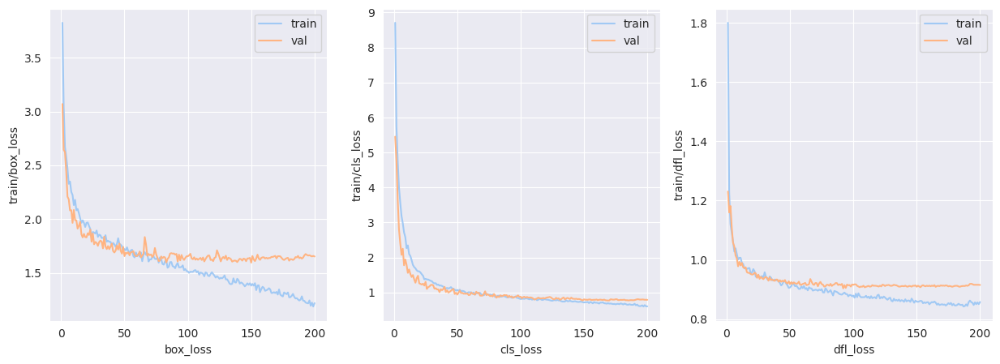

In [61]:
#Plotting the losses
plt.figure(figsize=(15,5))
k=1
for i in ['box_loss','cls_loss','dfl_loss']:
    ax=plt.subplot(1,3,k)
    sns.lineplot(df_result,x='epoch',y='train/'+i,label='train',ax=ax)
    sns.lineplot(df_result,x='epoch',y='val/'+i,label='val',ax=ax)
    ax.set_xlabel(i)
    k+=1


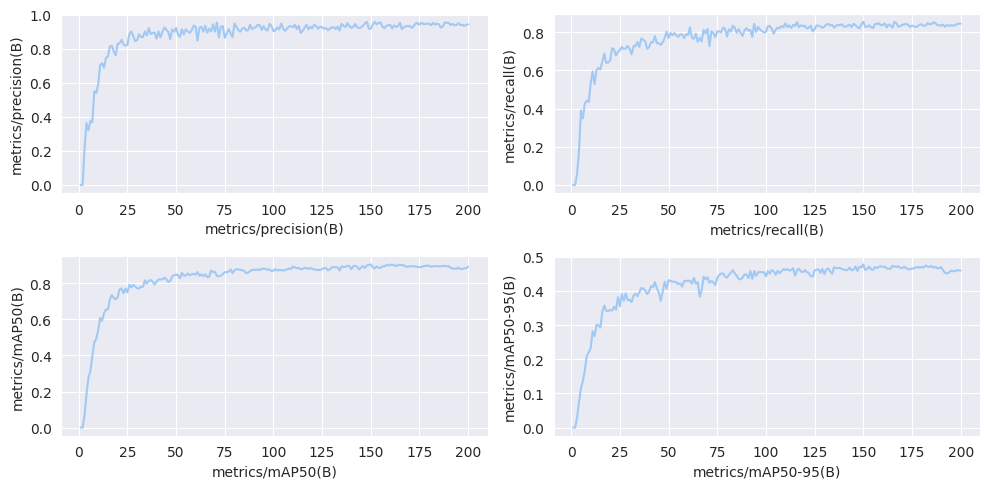

In [62]:
#Plotting the metrics
plt.figure(figsize=(10,5))
k=1
for i in ['metrics/precision(B)','metrics/recall(B)','metrics/mAP50(B)','metrics/mAP50-95(B)']:
    ax=plt.subplot(2,2,k)
    sns.lineplot(df_result,x='epoch',y=i,ax=ax)
    ax.set_xlabel(i)
    k+=1
plt.tight_layout()

In [63]:
#Creating function to visualize result:
def visualize_result(dir_name,list_images):
    k=1
    plt.figure(figsize=(20,15))
    for filename in list_images:
            ax=plt.subplot((len(list_images)//2+1),2,k)
            img_path=os.path.join(dir_name,filename)
            img=plt.imread(img_path)
            ax.imshow(img)
            ax.set_xlabel(filename)
            ax.grid(False)
            ax.set_xticks([])
            ax.set_yticks([])
            k+=1
    plt.tight_layout()
    plt.show()


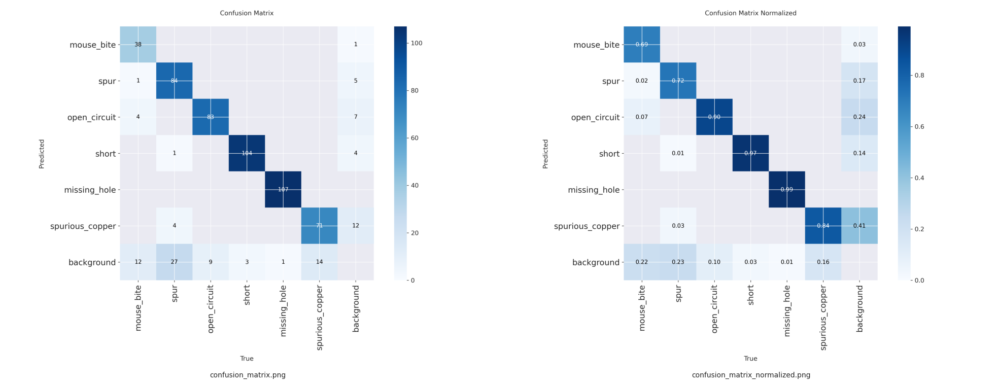

In [64]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_dir,list_confusion)

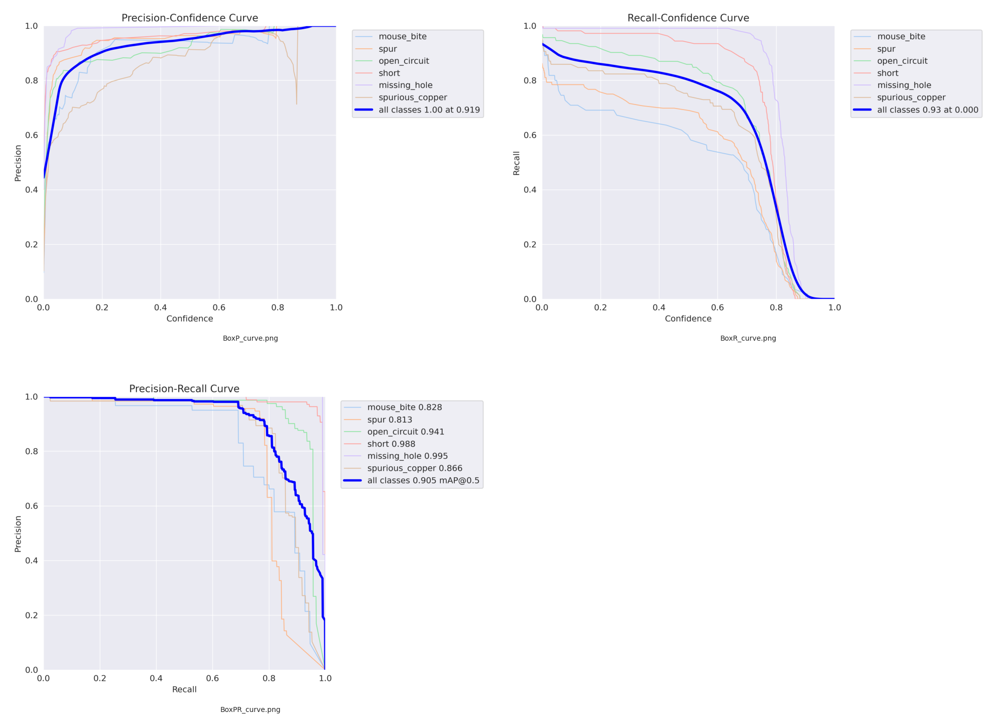

In [66]:
#Visualizing metrics
list_curve=['BoxP_curve.png','BoxR_curve.png','BoxPR_curve.png']
visualize_result(result_dir,list_curve)

In [67]:
#Now let's load our best model to evaluate
os.listdir(os.path.join(result_dir,'weights'))
best_model_path=os.path.join(result_dir,'weights','last.pt')
best_model=YOLO(best_model_path)

In [68]:
#Defing a function to view prediction against actual  along with bounding box

def draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,annotation_actual,annotation_predict):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    for bbox in bounding_boxes_actual:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_actual,(centroid_x,centroid_y),(max_x+20,max_y+20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

     # Draw each bounding box for predicted
    for bbox in bounding_boxes_predict:
        min_x, min_y, max_x, max_y = bbox
        width = max_x - min_x
        height = max_y - min_y
        rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='yellow', facecolor='none')
        ax.add_patch(rect)

        # Calculate the centroid of the bounding box
        centroid_x = (min_x + max_x) / 2
        centroid_y = (min_y + max_y) / 2

        # Add the annotation to the centroid
        ax.annotate( annotation_predict,(centroid_x,centroid_y),(min_x-20,min_y-20),
            fontsize=10,color='white',
            horizontalalignment='right', verticalalignment='top')

    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [69]:
#Defining the function to predict and return annoted image
def model_predict_compare(model,image_path,df_annot):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes_predict=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes

            annotation_predict=class_dict[pred_class]
        else:
            bounding_boxes_predict=[]
            annotation_predict=''


    filename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    df_selected=df_annot[df_annot['filename']==filename]

    xmin=df_selected['xmin'].values
    ymin=df_selected['ymin'].values
    xmax=df_selected['xmax'].values
    ymax=df_selected['ymax'].values

    annotation_actual=str(df_selected['class'].values[0])

    bounding_boxes_actual=zip(xmin,ymin,xmax,ymax)

    draw_bounding_boxes_predict_actual(image_path,bounding_boxes_actual,bounding_boxes_predict,'actual_'+annotation_actual,'predicted_'+annotation_predict)




image 1/1 /content/dataset/images/val/01_missing_hole_02.jpg: 352x640 3 missing_holes, 55.9ms
Speed: 5.3ms preprocess, 55.9ms inference, 1.7ms postprocess per image at shape (1, 3, 352, 640)


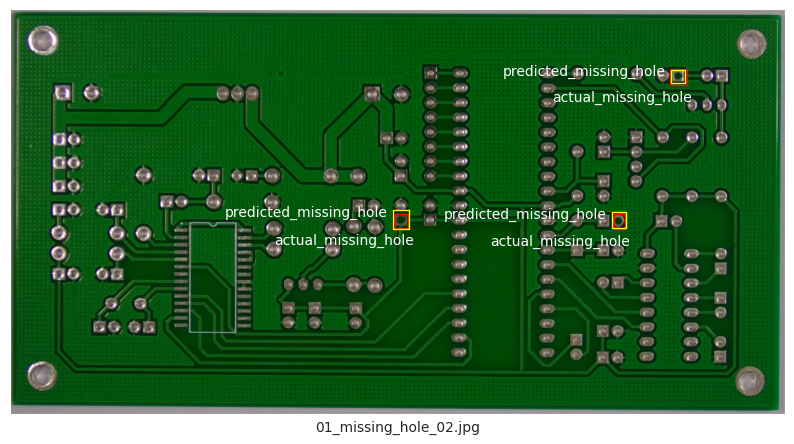


image 1/1 /content/dataset/images/val/11_spurious_copper_05.jpg: 640x640 5 spurious_coppers, 9.7ms
Speed: 4.6ms preprocess, 9.7ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


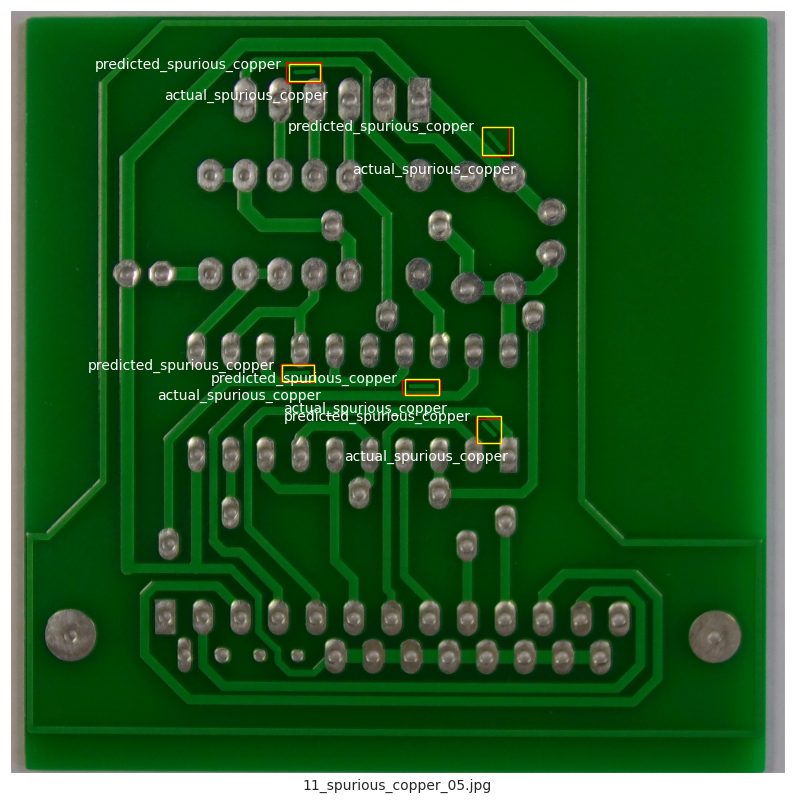


image 1/1 /content/dataset/images/val/07_open_circuit_10.jpg: 448x640 5 open_circuits, 76.3ms
Speed: 3.9ms preprocess, 76.3ms inference, 1.8ms postprocess per image at shape (1, 3, 448, 640)


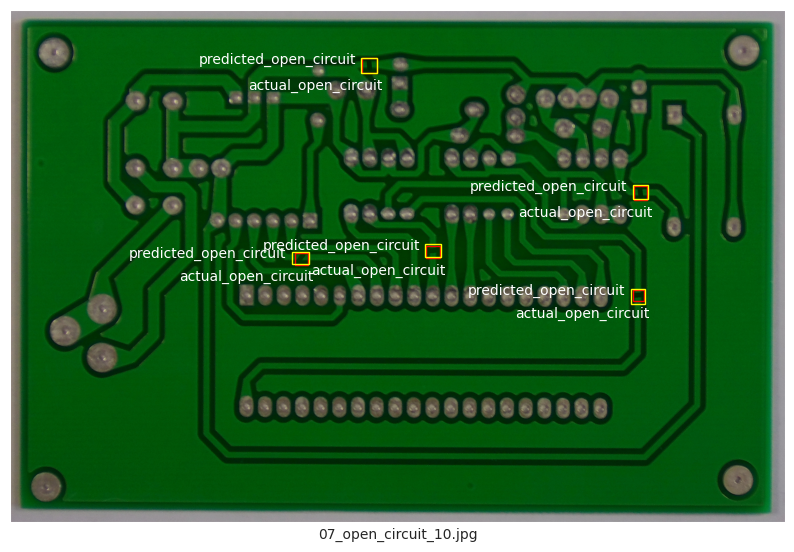


image 1/1 /content/dataset/images/val/01_mouse_bite_10.jpg: 352x640 1 mouse_bite, 11.7ms
Speed: 3.2ms preprocess, 11.7ms inference, 1.9ms postprocess per image at shape (1, 3, 352, 640)


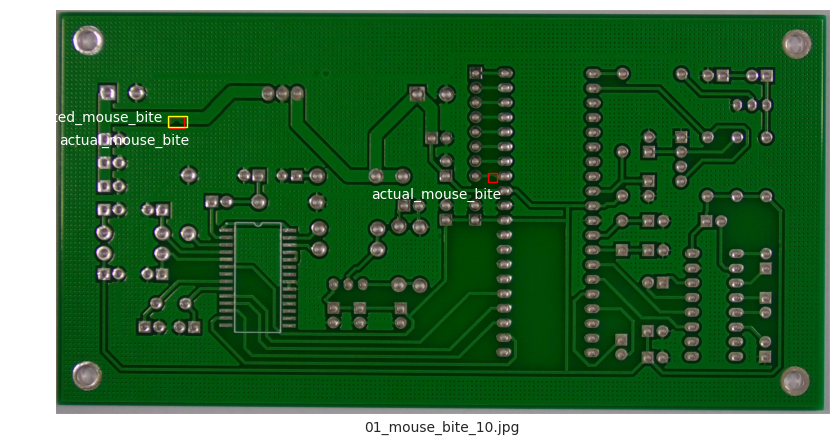


image 1/1 /content/dataset/images/val/12_short_08.jpg: 640x640 5 shorts, 12.1ms
Speed: 4.9ms preprocess, 12.1ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)


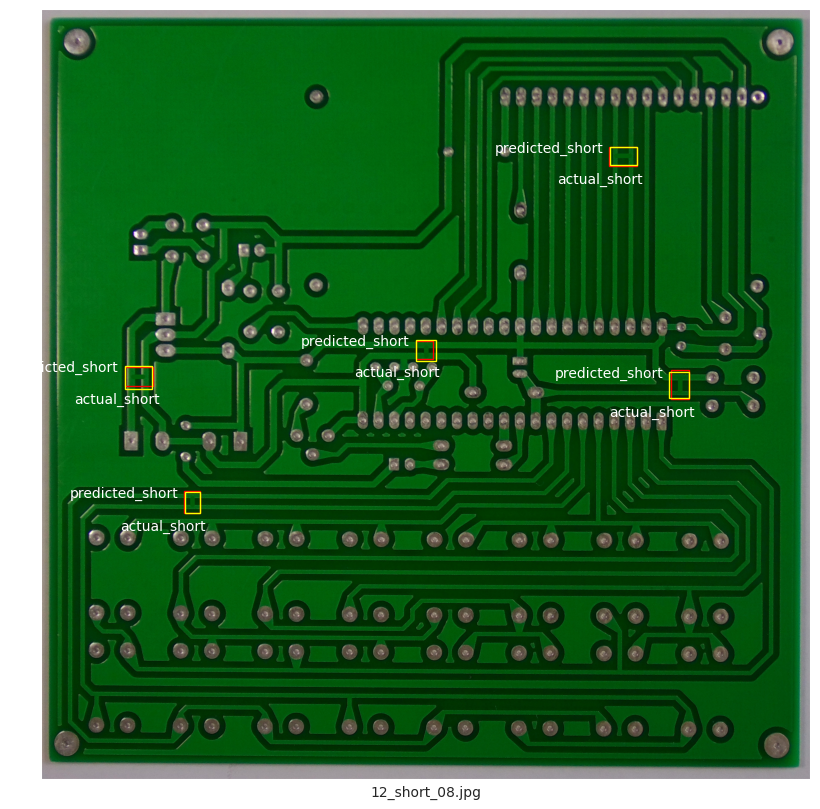

In [70]:
#Predicting on val data for 5 val images
val_image_dir=os.path.join(images_dir,'val')
for i in os.listdir(val_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(val_image_dir,i),df_annot)


image 1/1 /content/dataset/images/test/08_spurious_copper_08.jpg: 512x640 5 spurious_coppers, 92.9ms
Speed: 4.4ms preprocess, 92.9ms inference, 4.8ms postprocess per image at shape (1, 3, 512, 640)


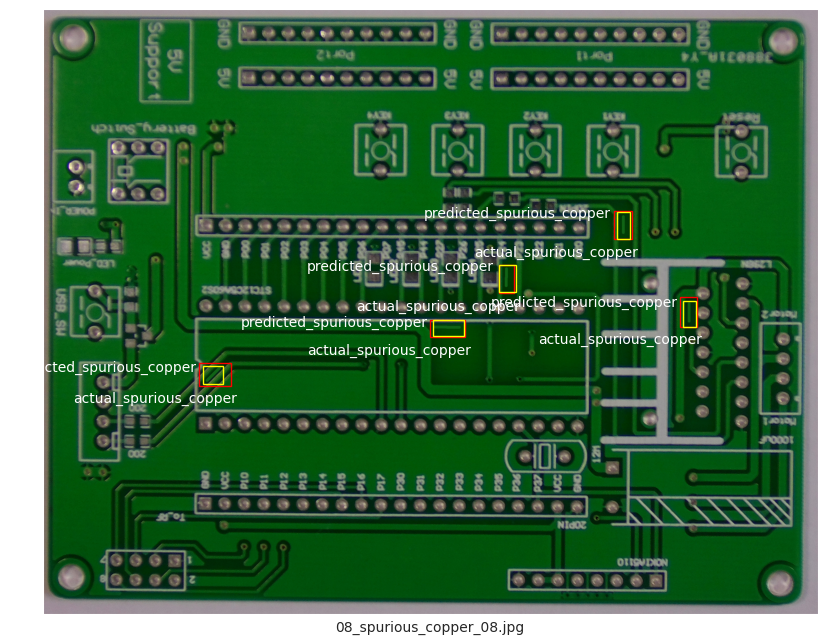


image 1/1 /content/dataset/images/test/09_short_04.jpg: 512x640 5 shorts, 11.0ms
Speed: 4.3ms preprocess, 11.0ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


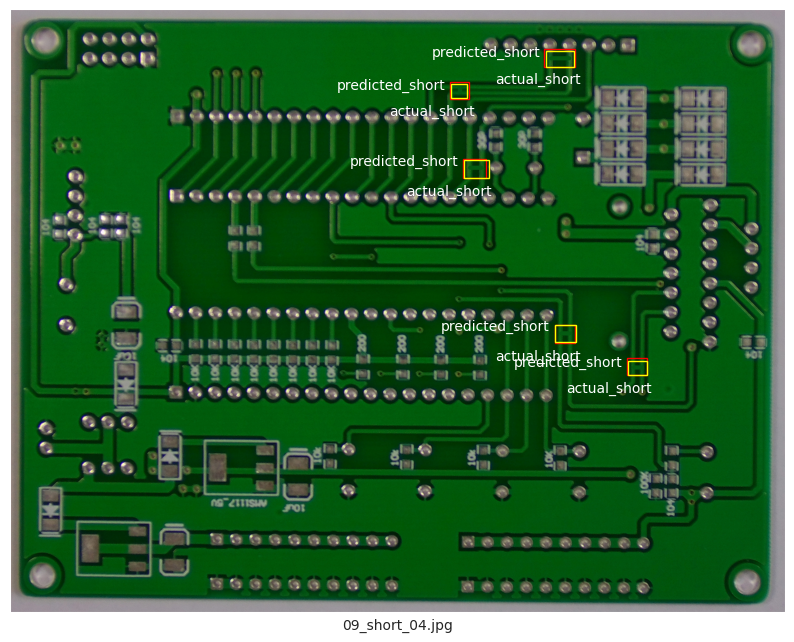


image 1/1 /content/dataset/images/test/05_short_07.jpg: 544x640 4 shorts, 78.6ms
Speed: 4.6ms preprocess, 78.6ms inference, 2.0ms postprocess per image at shape (1, 3, 544, 640)


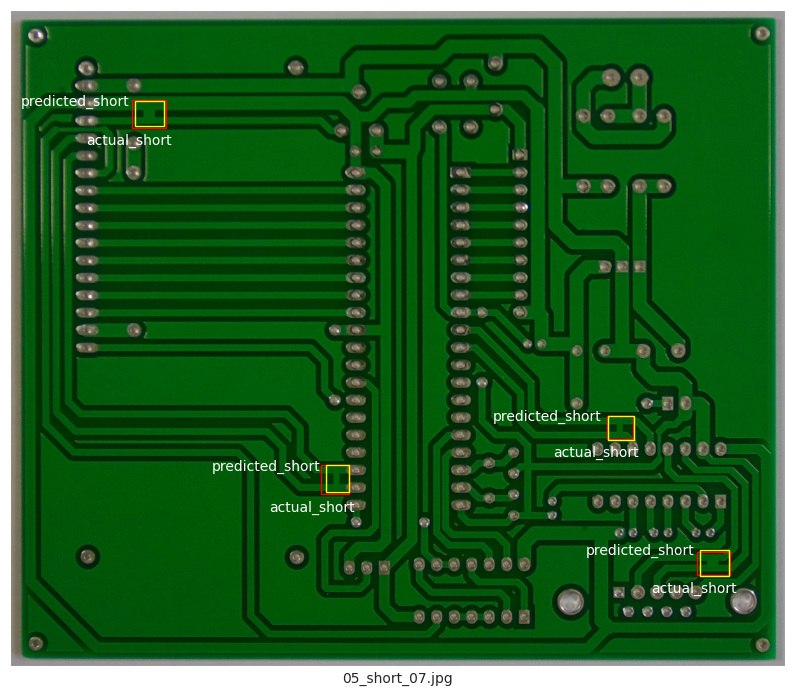


image 1/1 /content/dataset/images/test/07_spur_03.jpg: 448x640 4 spurs, 11.7ms
Speed: 3.7ms preprocess, 11.7ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


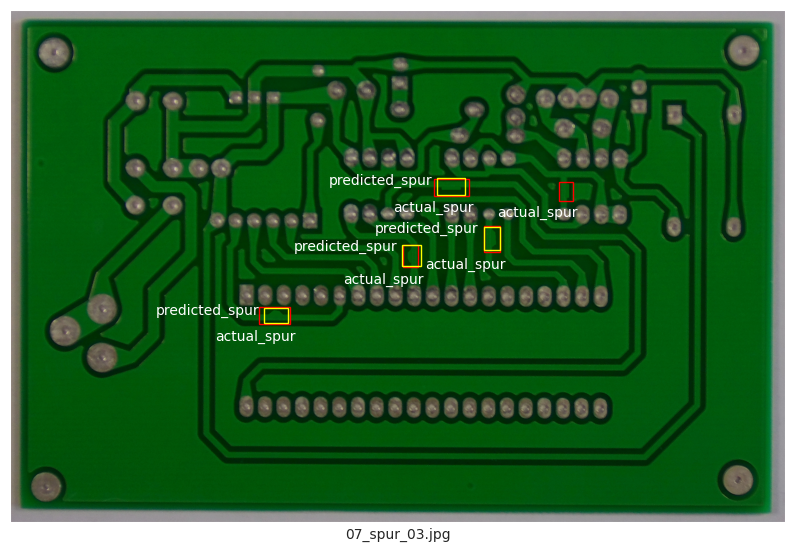


image 1/1 /content/dataset/images/test/09_spurious_copper_05.jpg: 512x640 5 spurious_coppers, 12.8ms
Speed: 4.2ms preprocess, 12.8ms inference, 1.5ms postprocess per image at shape (1, 3, 512, 640)


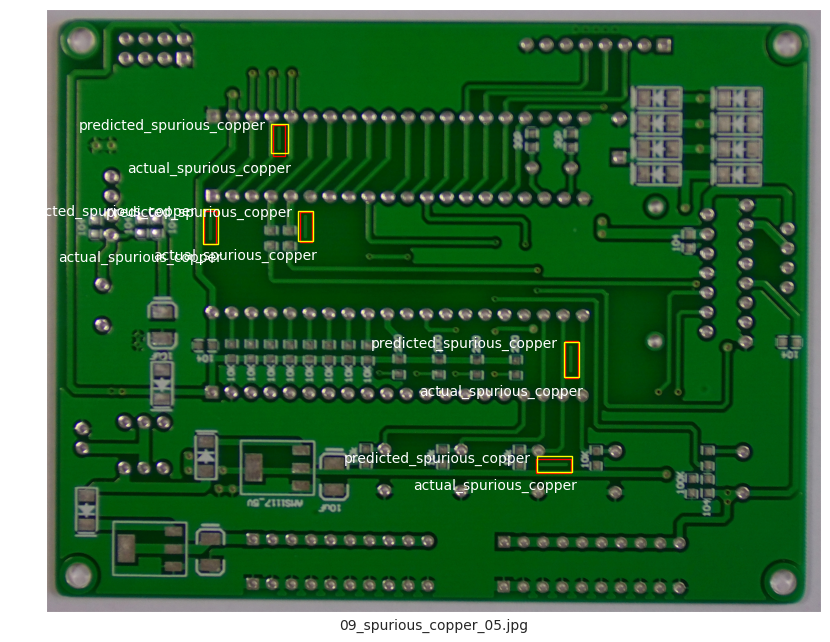

In [71]:
#Predicting on test data for 5 test images
test_image_dir=os.path.join(images_dir,'test')
for i in os.listdir(test_image_dir)[0:5]:
    model_predict_compare(best_model,os.path.join(test_image_dir,i),df_annot)

In [72]:
def move_to_dummy(original_dir,dummy_dir):
    if os.path.exists(dummy_dir):
        shutil.rmtree(dummy_dir) #Remove if exists
    os.makedirs(dummy_dir)

    images_dum_val_dir=os.path.join(dummy_dir,'images','val')
    labels_dum_val_dir=os.path.join(dummy_dir,'labels','val')
    images_dum_train_dir=os.path.join(dummy_dir,'images','train')
    labels_dum_train_dir=os.path.join(dummy_dir,'labels','train')

    os.makedirs(images_dum_val_dir)
    os.makedirs(labels_dum_val_dir)
    os.makedirs(images_dum_train_dir)
    os.makedirs(labels_dum_train_dir)

    images_test_dir=os.path.join(original_dir,'images','test')
    labels_test_dir=os.path.join(original_dir,'labels','test')
    images_train_dir=os.path.join(original_dir,'images','train')
    labels_train_dir=os.path.join(original_dir,'labels','train')

    for i in os.listdir(images_test_dir):
        shutil.copy(os.path.join(images_test_dir,i),os.path.join(images_dum_val_dir,i))
    for i in os.listdir(labels_test_dir):
        shutil.copy(os.path.join(labels_test_dir,i),os.path.join(labels_dum_val_dir,i))
    for i in os.listdir(images_train_dir):
        shutil.copy(os.path.join(images_train_dir,i),os.path.join(images_dum_train_dir,i))
    for i in os.listdir(labels_train_dir):
        shutil.copy(os.path.join(labels_train_dir,i),os.path.join(labels_dum_train_dir,i))

In [73]:
original_dir=os.path.join(root_dir,'dataset')
dummy_dir=os.path.join(root_dir,'dummy_dataset')

move_to_dummy(original_dir,dummy_dir)

print(f"Length of image files:{len(os.listdir(os.path.join(dummy_dir,'images','val')))}")
print(f"Length of label files:{len(os.listdir(os.path.join(dummy_dir,'labels','val')))}")

Length of image files:35
Length of label files:35


In [74]:
#Creating YAML format
data_test_yaml={
    'path':str(os.path.join(root_dir,'dummy_dataset')),
    'train':'images/train',
    'val':'images/val',
    'nc': len(class_dict),
    'names': list(class_dict.values())
}
data_test_yaml

{'path': '/content/dummy_dataset',
 'train': 'images/train',
 'val': 'images/val',
 'nc': 6,
 'names': ['mouse_bite',
  'spur',
  'open_circuit',
  'short',
  'missing_hole',
  'spurious_copper']}

In [75]:
#Creating yaml file
import yaml

#Writing to yaml file
with open('data_test.yaml', 'w') as f:
    yaml.dump(data_test_yaml, f, default_flow_style=False)

In [76]:
result_val=best_model.val(data=os.path.join(root_dir,'data_test.yaml'))

Ultralytics 8.3.246 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 3154.0±756.8 MB/s, size: 1381.1 KB)
val: Scanning /content/dummy_dataset/labels/val... 35 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 35/35 951.7it/s 0.0s
val: New cache created: /content/dummy_dataset/labels/val.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 3/3 1.4s/it 4.3s
                   all         35        151      0.952       0.88       0.92      0.494
            mouse_bite          4         16      0.909      0.812      0.818      0.437
                  spur          5         23      0.956      0.826       0.89      0.436
          open_circuit          5         19      0.977      0.895       0.99      0.581
                 short          6         29      0.942      0.966      0.988      0.564
          missing_hole          5         19          1      0.946    

In [77]:
result_val_dir='/content/runs/detect/val'

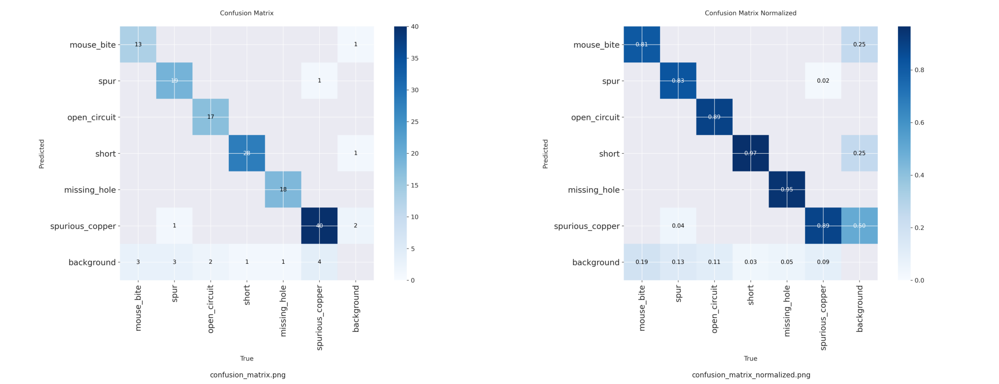

In [78]:
#Visualizing confusion matrix
list_confusion=['confusion_matrix.png','confusion_matrix_normalized.png']
visualize_result(result_val_dir,list_confusion)

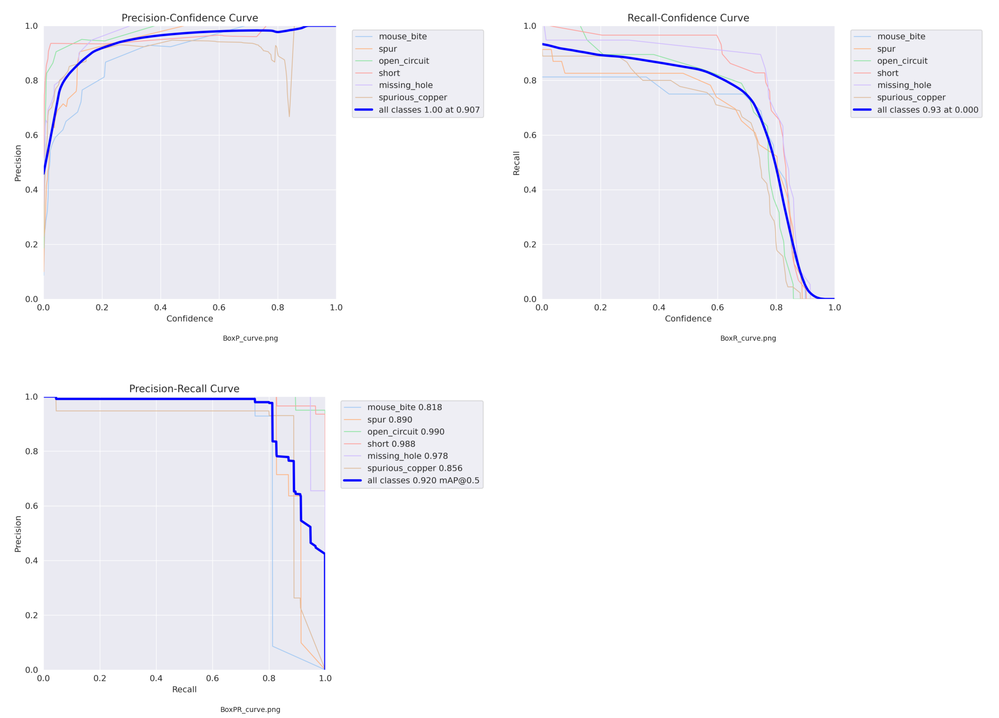

In [80]:
#Visualizing metrics
list_curve=['BoxP_curve.png','BoxR_curve.png','BoxPR_curve.png']
visualize_result(result_val_dir,list_curve)

In [81]:
#Defing a function to view image along with bounding box

def draw_bounding_boxes_image(image_path, bounding_boxes,annotation):
    """
    Draws multiple bounding boxes on an image using Matplotlib.

    Args:
        image_path: The path to the image file.
        bounding_boxes: A list of bounding boxes, each represented as a tuple or list containing
                       (min_x, min_y, max_x, max_y).
    """

    # Load the image
    img = plt.imread(image_path)

    # Create a figure and axis
    fig, ax = plt.subplots(figsize=(10,10))

    # Display the image
    ax.imshow(img)

    # Draw each bounding box for actual
    if len(bounding_boxes)==0:
        plt.text(0.5, 0.5, 'No defects detected',
                 horizontalalignment='center',verticalalignment='center',color='white',fontsize=16)

    else:
        for bbox in bounding_boxes:
            min_x, min_y, max_x, max_y = bbox
            width = max_x - min_x
            height = max_y - min_y
            rect = patches.Rectangle((min_x, min_y), width, height, linewidth=1, edgecolor='red', facecolor='none')
            ax.add_patch(rect)

            # Calculate the centroid of the bounding box
            centroid_x = (min_x + max_x) / 2
            centroid_y = (min_y + max_y) / 2

            # Add the annotation to the centroid
            ax.annotate( annotation,(centroid_x,centroid_y),(max_x+20,max_y+20),
                fontsize=10,color='white',
                horizontalalignment='right', verticalalignment='top')


    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    imagename=re.sub(r'.+/([\w_]+\.jpg)',r'\1',image_path)
    plt.xlabel(imagename)

    # Show the plot
    plt.show()

In [82]:
#Defining the function to predict and return annoted image
def model_predict(model,image_path):

    result_test=model.predict(image_path)
    for r in result_test:
        if r.boxes.xyxy.cpu().numpy().size!=0:
            bounding_boxes=r.boxes.xyxy.cpu().numpy()  #Numpy array of bounding box
            class_dict=r.names                         #Class dict
            pred_class=r.boxes.cls.cpu().numpy()[0].astype('int') #Predicted classes
            annotation=class_dict[pred_class]
        else:
            bounding_boxes=[]
            annotation=''



    draw_bounding_boxes_image(image_path, bounding_boxes,annotation)





image 1/1 /content/dummy_dataset/images/val/08_spurious_copper_08.jpg: 512x640 5 spurious_coppers, 21.1ms
Speed: 8.9ms preprocess, 21.1ms inference, 2.4ms postprocess per image at shape (1, 3, 512, 640)


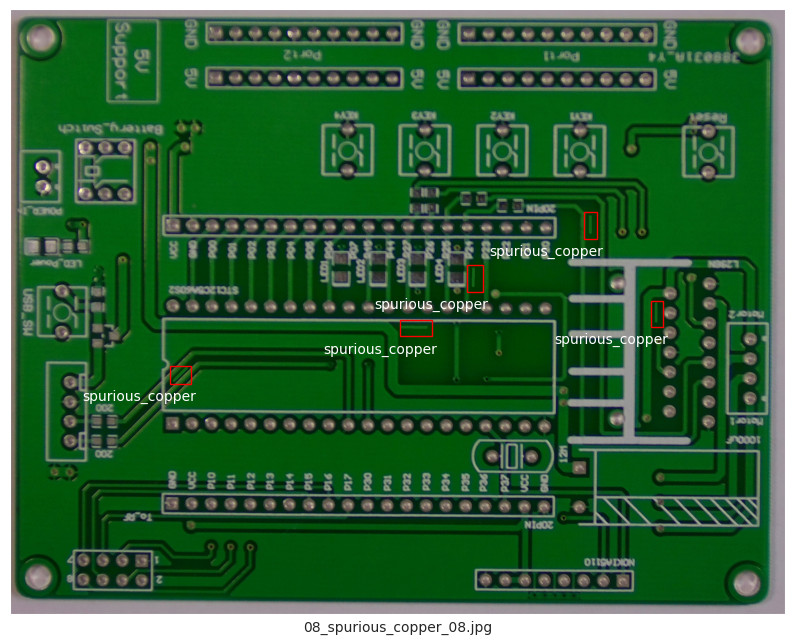


image 1/1 /content/dummy_dataset/images/val/05_short_07.jpg: 544x640 4 shorts, 12.2ms
Speed: 4.4ms preprocess, 12.2ms inference, 1.4ms postprocess per image at shape (1, 3, 544, 640)


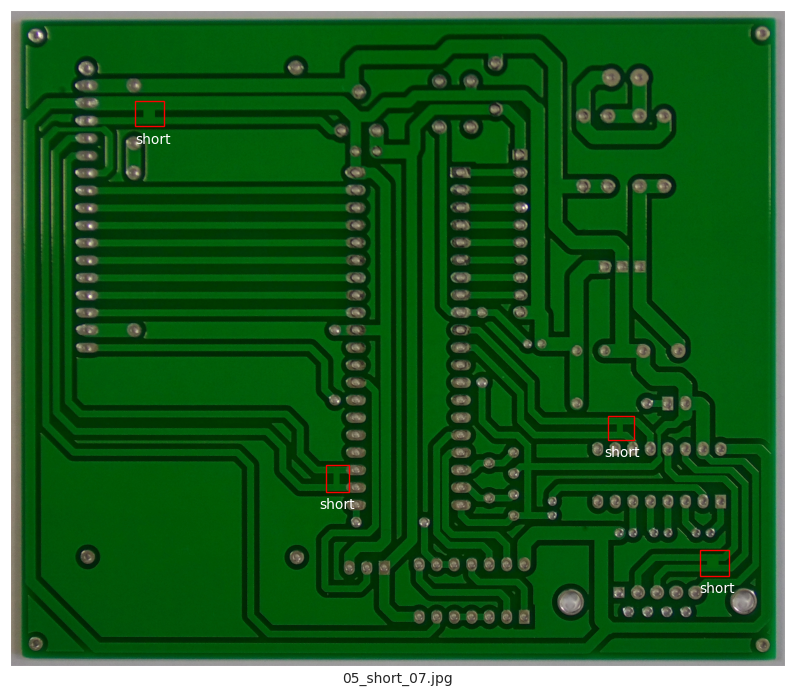


image 1/1 /content/dummy_dataset/images/val/09_spurious_copper_05.jpg: 512x640 5 spurious_coppers, 11.6ms
Speed: 4.4ms preprocess, 11.6ms inference, 1.8ms postprocess per image at shape (1, 3, 512, 640)


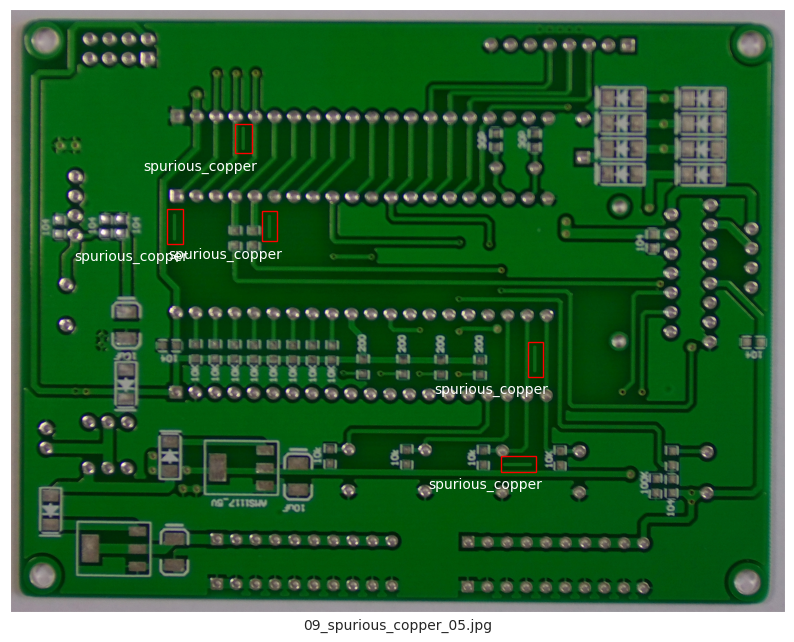


image 1/1 /content/dummy_dataset/images/val/05_open_circuit_02.jpg: 544x640 3 open_circuits, 11.3ms
Speed: 4.6ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 544, 640)


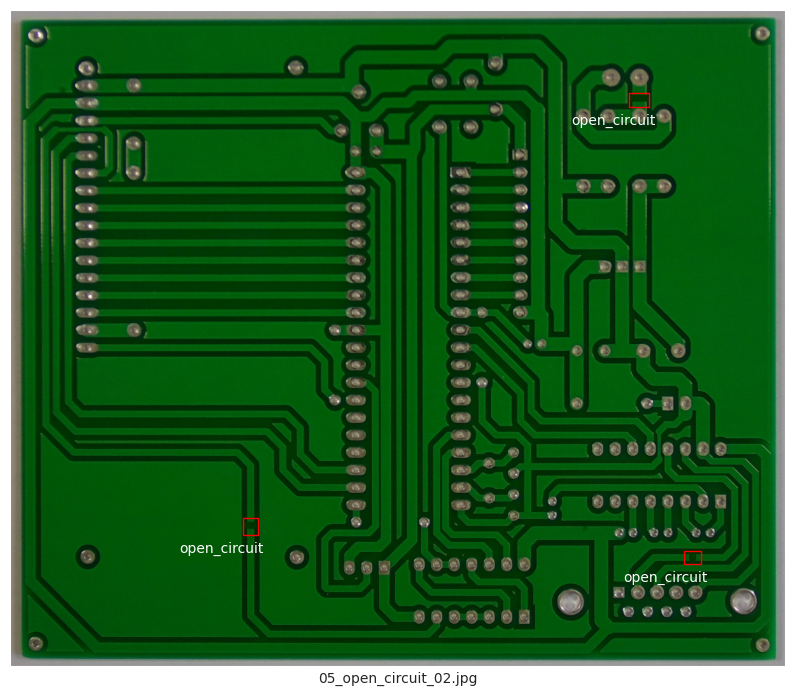


image 1/1 /content/dummy_dataset/images/val/12_spur_01.jpg: 640x640 5 spurs, 11.7ms
Speed: 5.0ms preprocess, 11.7ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)


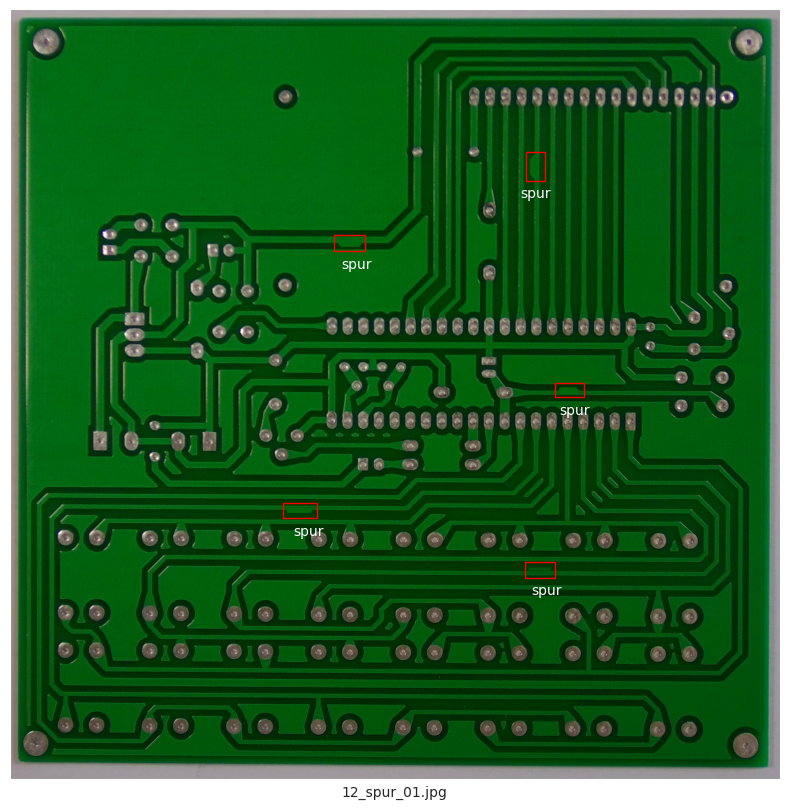

In [83]:
#Testing on sample data
for i in os.listdir(os.path.join(dummy_dir,'images','val'))[0:10:2]:
    image_path=os.path.join(dummy_dir,'images','val',i)
    model_predict(model=best_model,image_path=image_path)

In [84]:
for i in os.listdir(os.path.join(dummy_dir,'images','val'))[0:10:2]:
    print(i)

08_spurious_copper_08.jpg
05_short_07.jpg
09_spurious_copper_05.jpg
05_open_circuit_02.jpg
12_spur_01.jpg


In [85]:
import torch
torch.save(model.state_dict(), 'pcb_defect_yolov5n_model.pth')

In [87]:
best_model.export(format='saved_model', keras=True)

Ultralytics 8.3.246 🚀 Python-3.12.12 torch-2.9.0+cu126 CPU (Intel Xeon CPU @ 2.00GHz)
💡 ProTip: Export to OpenVINO format for best performance on Intel hardware. Learn more at https://docs.ultralytics.com/integrations/openvino/

PyTorch: starting from 'runs/detect/train/weights/last.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 10, 8400) (5.2 MB)
requirements: Ultralytics requirements ['ai-edge-litert>=1.2.0', 'onnxruntime-gpu'] not found, attempting AutoUpdate...
Using Python 3.12.12 environment at: /usr
Resolved 13 packages in 7.69s
Prepared 3 packages in 8.32s
Installed 3 packages in 52ms
 + ai-edge-litert==2.1.0
 + backports-strenum==1.3.1
 + onnxruntime-gpu==1.23.2

requirements: AutoUpdate success ✅ 16.5s
WARNING ⚠️ requirements: Restart runtime or rerun command for updates to take effect


TensorFlow SavedModel: starting export with tensorflow 2.19.0...

ONNX: starting export with onnx 1.20.0 opset 22...
ONNX: slimming with onnxslim 0.1.82...
ONNX: export su

'runs/detect/train/weights/last_saved_model'